# Chord classifier


## Data preprocessing

In [16]:
conda install -c conda-forge ffmpeg libsndfile pandas numpy librosa matplotlib pytorch torchvision

Channels:
 - conda-forge
 - defaults
Platform: osx-64
Solving environment: done

## Package Plan ##

  environment location: /Users/admin/miniconda3/envs/chordenv

  added / updated specs:
    - ffmpeg
    - librosa
    - libsndfile
    - matplotlib
    - numpy
    - pandas
    - pytorch
    - torchvision


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    blas-2.120                 |         openblas          14 KB  conda-forge
    blas-devel-3.9.0           |20_osx64_openblas          14 KB  conda-forge
    future-0.18.3              |     pyhd8ed1ab_0         357 KB  conda-forge
    liblapacke-3.9.0           |20_osx64_openblas          14 KB  conda-forge
    libpng-1.6.39              |       h6c40b1e_0         290 KB
    libuv-1.46.0               |       h0c2f820_0         387 KB  conda-forge
    openblas-0.3.25            |openmp_h6794695_0         5.2 MB  conda-forge
    pytorch-1.

In [2]:
%pip install spleeter

Note: you may need to restart the kernel to use updated packages.


The purpose of preprocessing step, which is crucial for training the model, is to convert each chord represented as `wav` file into   spectrograms.


In [12]:
from pathlib import Path
import os
import pandas as pd
import numpy as np

The scripts created for data preprocessing will be saved to code folder to ease their use in pipelines.

In [13]:
CODE_DIR = Path("code")
CODE_DIR.mkdir(parents=True, exist_ok=True)

In [14]:
data_dir = "data"
preprocessed_train_data_dir = Path(os.path.join(data_dir, "preprocessed", "train"))
preprocessed_test_data_dir = Path(os.path.join(data_dir, "preprocessed", "test"))
preprocessed_train_data_dir.mkdir(parents=True, exist_ok=True)
preprocessed_test_data_dir.mkdir(parents=True, exist_ok=True)


### Data exploration


Show the number of chord recordings available for training and testing

In [6]:
train_data_dir = data_dir + "/Training"
test_data_dir = data_dir + "/Test"

def get_chord_counts(data_dir):
    chord_counts = {}

    for chord in os.listdir(data_dir):
        chord_path = os.path.join(data_dir, chord)
        if os.path.isdir(chord_path):
            chord_counts[chord] = len(os.listdir(chord_path))

    return chord_counts

In [7]:
print(f"Training data chord count {get_chord_counts(train_data_dir)}")
print(f"Testing data chord count {get_chord_counts(test_data_dir)}")

Training data chord count {'Am': 180, 'Bb': 180, 'Em': 180, 'G': 180, 'F': 180, 'Dm': 180, 'C': 180, 'Bdim': 180}
Testing data chord count {'Am': 40, 'Bb': 40, 'Em': 40, 'G': 40, 'F': 40, 'Dm': 40, 'C': 40, 'Bdim': 40}


Show the duration of sounds of chords. It ranges from 1.12 to 16.34 seconds with median about 5 seconds.

In [8]:
import librosa

durations = []

for chord in os.listdir(train_data_dir):
    chord_path = os.path.join(train_data_dir, chord)
    if os.path.isdir(chord_path):
        for file in os.listdir(chord_path):
            file_path = os.path.join(chord_path, file)
            y, sr = librosa.load(file_path, sr=None)
            durations.append(librosa.get_duration(y=y, sr=sr))

durations_df = pd.DataFrame(durations, columns=['duration'])
durations_df.describe()

,duration
count,1440.000000
mean,5.631320
std,2.448665
min,1.123563
25%,4.381312
50%,5.048063
75%,6.000000
max,16.343855


A little trick to create an image from a spectrogram with matplotlib and then save it.

In [9]:
import os
import librosa
import librosa.display
import matplotlib.pyplot as plt

def create_spectrogram(audio_input, sr=None, save_path=None):
    # skip already existing sprectrogram
    if os.path.exists(save_path):
        print(f"Spectrogram  {save_path} already exists. Skipping.")
        return

    # Load the audio file if a path is provided, else use the provided audio data
    if isinstance(audio_input, str):
        y, sr = librosa.load(audio_input, sr=None)
    else:
        y = audio_input
        if sr is None:
            raise ValueError("Sampling rate must be provided with audio data")

    print(f"Creating spectrogram {save_path}")

    # Generate the Mel spectrogram
    S = librosa.feature.melspectrogram(y=y, sr=sr)
    S_dB = librosa.power_to_db(S, ref=np.max)

    # Plot and save the spectrogram
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(S_dB, sr=sr, x_axis='time', y_axis='mel')
    plt.axis('off')
    plt.xticks([]), plt.yticks([])
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, bbox_inches='tight', pad_inches=0)
    plt.close()

    return S_dB


In [10]:
def convert_chords_to_spectrograms(source_dir, destination_dir):
    for chord in os.listdir(source_dir):
        chord_path = os.path.join(source_dir, chord)
        preprocessed_chord_path = os.path.join(destination_dir, chord)

        if not os.path.exists(preprocessed_chord_path):
            os.makedirs(preprocessed_chord_path)

        if os.path.isdir(chord_path):
            for file in os.listdir(chord_path):
                file_path = os.path.join(chord_path, file)

                y, sr = librosa.load(file_path, sr=None)

                # Calculate the number of samples per beat
                # 0.5 is the closest to average beat length so we will use this value for training
                beat_duration = 0.5
                samples_per_beat = int(beat_duration * sr)

                for i in range(0, len(y), samples_per_beat):
                    end_frame = i + samples_per_beat
                    if end_frame > len(y):
                        end_frame = len(y)  # Adjust the end frame for the last segment

                    segment = y[i:end_frame]
                    save_path = os.path.join(preprocessed_chord_path, os.path.splitext(file)[0] + "_" + str(i // samples_per_beat) + ".png")
                    # create spectrogram from a segment and save it to disk
                    create_spectrogram(segment, sr, save_path)


Convert train and test data. This will take a few minutes.


In [11]:
convert_chords_to_spectrograms(train_data_dir, preprocessed_train_data_dir)
convert_chords_to_spectrograms(test_data_dir, preprocessed_test_data_dir)

Spectrogram  data/preprocessed/train/Am/Am_acousticguitar_SalomC╠ºAndrade_2_0.png already exists. Skipping.
Spectrogram  data/preprocessed/train/Am/Am_acousticguitar_SalomC╠ºAndrade_2_1.png already exists. Skipping.
Spectrogram  data/preprocessed/train/Am/Am_acousticguitar_SalomC╠ºAndrade_2_2.png already exists. Skipping.
Spectrogram  data/preprocessed/train/Am/Am_acousticguitar_SalomC╠ºAndrade_2_3.png already exists. Skipping.
Spectrogram  data/preprocessed/train/Am/Am_acousticguitar_SalomC╠ºAndrade_2_4.png already exists. Skipping.
Spectrogram  data/preprocessed/train/Am/Am_acousticguitar_SalomC╠ºAndrade_2_5.png already exists. Skipping.
Spectrogram  data/preprocessed/train/Am/Am_acousticguitar_SalomC╠ºAndrade_2_6.png already exists. Skipping.
Spectrogram  data/preprocessed/train/Am/Am_acousticguitar_SalomC╠ºAndrade_2_7.png already exists. Skipping.
Spectrogram  data/preprocessed/train/Am/Am_AcusticPlug16_1_0.png already exists. Skipping.
Spectrogram  data/preprocessed/train/Am/Am_Ac

Let's check the number of generated files.

In [18]:
print(f"Training data chord count {get_chord_counts(preprocessed_train_data_dir)}")
print(f"Testing data chord count {get_chord_counts(preprocessed_test_data_dir)}")

Training data chord count {'Am': 2115, 'Bb': 2107, 'Em': 2143, 'G': 2134, 'F': 2062, 'Dm': 2120, 'C': 2132, 'Bdim': 2047}
Testing data chord count {'Am': 379, 'Bb': 382, 'Em': 422, 'G': 409, 'F': 393, 'Dm': 394, 'C': 408, 'Bdim': 380}


An example of a spectrogram

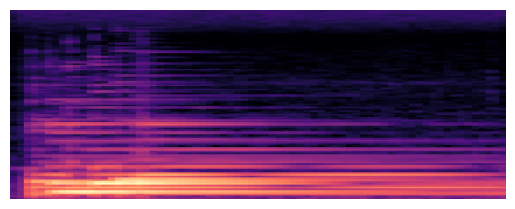

In [15]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

image_path = os.path.join(preprocessed_train_data_dir, 'Am', 'Am_acousticguitar_Mari_1.png')

img = mpimg.imread(image_path)

# Display the image
plt.imshow(img)
plt.axis('off')
plt.show()

## Track splitting


In [16]:
songs_dir = "songs"
separated_songs_dir = os.path.join(songs_dir, "separated")
song_file_name = "Have-You-Ever-Seen-The-Rain"
song_path = os.path.join(songs_dir, song_file_name + ".mp3")

Extracting the guitar track from the uploaded song. Let's check this feature on the Have You Ever Seen The Rain by Creedence Clearwater Revival which has a distinctive guitar track.


In [17]:
from IPython.display import Audio

Audio(song_path)


Spleeter will divide the song into 4 separate tracks: bass, drums, vocals and other. The guitar will be contained in "other".

In [18]:
import subprocess

command = f"spleeter separate -p spleeter:4stems -o {separated_songs_dir} {song_path}"
subprocess.run(command, shell=True)

INFO:spleeter:File songs/separated/Have-You-Ever-Seen-The-Rain/other.wav written succesfully
INFO:spleeter:File songs/separated/Have-You-Ever-Seen-The-Rain/bass.wav written succesfully
INFO:spleeter:File songs/separated/Have-You-Ever-Seen-The-Rain/vocals.wav written succesfully
INFO:spleeter:File songs/separated/Have-You-Ever-Seen-The-Rain/drums.wav written succesfully


CompletedProcess(args='spleeter separate -p spleeter:4stems -o songs/separated songs/Have-You-Ever-Seen-The-Rain.mp3', returncode=0)

In [19]:
guitar_track_path = os.path.join(separated_songs_dir, song_file_name, "other.wav")

Audio(guitar_track_path)


## Generating spectrograms from the extracted track


In [25]:
output_dir = Path(os.path.join("data", "extracted", song_file_name))

The following function will process each segment of a track and convert it to a spectrogram. The spectrogram will be returned to be used as input to CNN and also will be saved to disk so that if we want to process the same track again, we could use existing data.

The following function detects beat length and generates a spectrogram for each beat. Currently, it returns an array of spectrograms. Later on, predictions of a chord with CNN will be plugged in and it will return a list of predictions.

In [47]:
def process_track(audio_path, output_dir):
    y, sr = librosa.load(audio_path, sr=None)
    tempo, _ = librosa.beat.beat_track(y=y, sr=sr)

    print(f"Track tempo is {tempo}")
    beat_duration = 60.0 / tempo  # Duration of a beat in seconds

    print(f"Beat duration is {beat_duration} seconds")

    # Calculate the number of samples per beat
    samples_per_beat = int(beat_duration * sr)

    print(f"Samples per beat: {samples_per_beat}")

    spectrograms = []
    for i in range(0, len(y), samples_per_beat):
        end_frame = i + samples_per_beat
        if end_frame > len(y):
            end_frame = len(y)  # Adjust the end frame for the last segment

        segment = y[i:end_frame]
        filename = f'spectrogram_{i // samples_per_beat}.png'
        spectrogram = create_spectrogram(segment, sr, os.path.join(output_dir, filename))
        spectrograms.append(spectrogram)

    return spectrograms


If we have spectrograms already stored on the disk, we will use the following function to read them to provide as input to the CNN.

In [32]:
from PIL import Image
import numpy as np
import os

def load_spectrograms(output_dir):
    spectrograms = []
    for filename in os.listdir(output_dir):
        if filename.endswith('.png'):  # Ensure to load only PNG files
            file_path = os.path.join(output_dir, filename)
            with Image.open(file_path) as img:
                spectrogram = np.array(img)
                spectrograms.append(spectrogram)
    return spectrograms

To keep things simple, we will consider that the track already processed if the directory with the song name already exists. We can implement more sophisticated and robust checks like file hash sum later.

In [48]:
if os.path.exists(output_dir):
    print("The track is already processed, load from disk")
    spectrograms = load_spectrograms(output_dir)
else:
    os.makedirs(output_dir)
    print("Processing track")
    spectrograms = process_track(guitar_track_path, output_dir)

print(spectrograms[:10])


Processing track
Track tempo is 117.45383522727273
Beat duration is 0.5108390022675736 seconds
Samples per beat: 22527
[array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32), array([[-80.      , -80.      , -80.      , ..., -61.63836 , -67.03239 ,
        -58.966393],
       [-80.      , -80.      , -80.      , ..., -66.40463 , -65.62964 ,
        -57.080696],
       [-80.      , -80.      , -80.      , ..., -62.885292, -69.69378 ,
        -59.910706],
       ...,
       [-80.      , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ],
       [-80.      , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ],
       [-80.      , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ]], dtype=float32), array([[-49.081875, -55.816387

Let's visualize an example of generated spectrogram

Displaying the image at data/extracted/Have-You-Ever-Seen-The-Rain/spectrogram_41.png


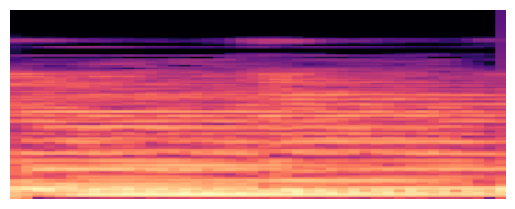

In [49]:
files = os.listdir(output_dir)
image_path = os.path.join(output_dir, files[100])

print(f"Displaying the image at {image_path}")

img = mpimg.imread(image_path)

# Display the image
plt.imshow(img)
plt.axis('off')
plt.show()


## Fine tuning ResNet50


In [2]:
import torch
import torchvision.models as models
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset


Load the model and enable the last layer for fine tuning

In [3]:
num_classes = 8 # we have 8 chords in our dataset
model = models.resnet50(pretrained=True)

# replacing the last layer for fine tuning
num_features = model.fc.in_features
model.fc = nn.Linear(num_features, num_classes)


/Users/admin/miniconda3/envs/chordenv/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/admin/miniconda3/envs/chordenv/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Define our dataset


In [4]:
class SpectrogramDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        """
        Args:
            root_dir (string): Directory with all the subdirectories for each label.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.transform = transform
        self.samples = []

        # Iterate over each subdirectory in root_dir
        for label_dir in os.listdir(root_dir):
            label_dir_full_path = os.path.join(root_dir, label_dir)
            if os.path.isdir(label_dir_full_path):
                # Iterate over each file in the subdirectory
                for file in os.listdir(label_dir_full_path):
                    file_full_path = os.path.join(label_dir_full_path, file)
                    if os.path.isfile(file_full_path):
                        # Append the file path and its label to the samples list
                        self.samples.append((file_full_path, label_dir))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        img_path, label = self.samples[idx]
        img = Image.open(img_path)

        if self.transform:
            img = self.transform(img)

        return img, label


TODO: double check implementation

In [5]:
from PIL import Image, ImageOps

def resize_and_pad(spectrogram, target_size=(224, 224)):
    # Calculate the resize ratio and resize the spectrogram
    ratio = min(target_size[0] / spectrogram.width, target_size[1] / spectrogram.height)
    new_size = (int(spectrogram.width * ratio), int(spectrogram.height * ratio))
    spectrogram = spectrogram.resize(new_size, Image.ANTIALIAS)

    # Calculate padding
    delta_width = target_size[0] - new_size[0]
    delta_height = target_size[1] - new_size[1]
    padding = (delta_width // 2, delta_height // 2, delta_width - (delta_width // 2), delta_height - (delta_height // 2))

    # Add padding
    return ImageOps.expand(spectrogram, padding)


A function to calculate mean and standard deviation for normalization.


In [6]:
from torchvision import transforms
from torch.utils.data import DataLoader
import torch

def calculate_mean_std(loader):
    mean = 0.
    std = 0.
    total_images_count = 0
    for images, _ in loader:
        batch_samples = images.size(0)
        images = images.view(batch_samples, images.size(1), -1)
        mean += images.mean(2).sum(0)
        std += images.std(2).sum(0)
        total_images_count += batch_samples

    mean /= total_images_count
    std /= total_images_count
    return mean, std


Transform the data to the input format expected by the network. This step without the normalization as we first need to calculate the mean and standard deviation.


In [7]:
from torchvision import transforms

pre_transform = transforms.Compose([
    transforms.Lambda(resize_and_pad),
    transforms.ToTensor(),
])


The following operation is to calculate mean and std across the training dataset for normalization. The next cell is disabled because this operation takes long time to run. Instead, I will hardcode the values received from it earlier.

In [11]:
%%script false --no-raise-error
#| code: true
#| output: false
#} eval: false

pre_dataset = SpectrogramDataset(root_dir=preprocessed_train_data_dir, transform=pre_transform)

pre_loader = DataLoader(pre_dataset, batch_size=64, shuffle=True, num_workers=0)

mean, std = calculate_mean_std(pre_loader)
print(mean, std)


/var/folders/cx/sg9_jgz17l94q95yk400hy980000gn/T/ipykernel_17099/2522708015.py:7: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  spectrogram = spectrogram.resize(new_size, Image.ANTIALIAS)


tensor([0.1928, 0.0816, 0.1363, 0.3795]) tensor([0.3131, 0.1567, 0.1977, 0.4853])


In [ ]:
mean = [0.1928, 0.0816, 0.1363, 0.3795]
std = [0.3131, 0.1567, 0.1977, 0.4853]

tensor([0.1928, 0.0816, 0.1363, 0.3795]) tensor([0.3131, 0.1567, 0.1977, 0.4853])

Now that we have all necessary information, we can fully transform the dataset.

In [ ]:
transform = transforms.Compose([
    transforms.Lambda(resize_and_pad),
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std),
])

In [ ]:
dataset = SpectrogramDataset(root_dir=preprocessed_train_data_dir, transform=transform)

Create validation dataset

In [ ]:
from torch.utils.data import random_split

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, validation_dataset = random_split(dataset, [train_size, val_size])
